# Lightweight ML Model for Animal Tracking Edge AI: Hierarchical Bounding Boxes

CS211 Group Project

Yi-chun Lo, Gian Zignago, Taichang Zhao

University of California, Los Angeles

## Project Description

### Context
In the dynamic world of IoT, we're bridging the gap between AI and edge computing, transforming technology interaction. Despite edge devices often have limitations in power and computation capabilities, many interdisciplinary research still call for the need of edge AI. One workable solution is to deploy lightweight machine learning models on the edge, and perform heavy duty machine learning tasks in a centralized server.
In our context, we focus on the interdisciplinary research of AI-driven ethology research. Non-trivial effort is required to deploy efficient, lightweight ML models on the edge to perform object detection and tracking tasks and deliver accurate, reliable results.

### Problem Statement
In this project, we aim to train a lightweight model for object detection and tracking, specifically for animal and animal bodypart tracking. For this project, the animals of interest are in the Panthera lineage of the Felidae family, namely lions (Panthera leo) and tigers (Panthera tigris). Given a video, the model should detect and track the animal of interest. More importantly, it is useful to further track the animal’s separate body parts (e.g. torso, head, limbs, and tails) for behavior analysis purposes.

### Goal
The goal is to train and evaluate a lightweight model to detect and track the animal (lion/tiger) and its separate body parts.

### Tasks
- Track the entire animal (lion/tiger) with a single bounding box, train and evaluate this model accuracy (High Priority)
- Given the above model for the entire animal, track the different body parts of the animal (say, five parts of head, tail, front legs, rear legs, and body trunk) using more bounding boxes, train and evaluate the accuracy of these detailed models (High Priority)
- Use spatial information among the different body parts to improve accuracy of the model (e.g. Inverse Kinematics) (Medium Priority)
- Bonus: Explore background object detection and exclusion (low priority).

### Expected outcome
Two-level bounding box models to track the entire animal and various animal body parts; evaluation metric and workflow.

## Part I: Bounding Box for Whole Tiger Detection
### Step 1: Set Up
Mounting Google Drive and download the ATRW datasets.

The ARTW dataset used in this file can be accessed at https://cvwc2019.github.io/challenge.html

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')
!pip install mediapipe-model-maker
!pip install tensorflow==2.15.0
!pip install keras==2.15.0

In [ ]:
# !mkdir /content/drive/MyDrive/211_datasets/
# %cd /content/drive/MyDrive/211_datasets/

#### Dataset Format
The first part of dataset is in Pascal VOC format. The structure is like this:
```
|---- 211_datasets
|     |---- test
|     |     |---- images
|     |     |     |---- 0001.jpg
|     |     |     |---- ...
|     |---- train
|     |     |---- images
|     |     |     |---- 0002.jpg
|     |     |     |---- ...
|     |     |---- Annotations
|     |     |     |----
|     |     |     |----
|     |---- val
|     |     |---- images
|     |     |     |---- 0000.jpg
|     |     |     |---- ...
|     |     |---- Annotations
|     |     |     |----
|     |     |     |----
```

In [ ]:
#!gdown 1-Bhhu_vLLZV_nMcBxvPy-S__EeP3TZnP
#!gdown 1-C40ACJLZcrX64ecKQB1N7fBhQdv4jdY
#!gdown 1-CfoXfsXFdA-elU_B--Tcu4eZ7ho6F-1
!gdown 1tqdBIdor_JXosYHFm1GCfTk8LPqvfUQB # train
!gdown 1-6q7Qf8VfpxSfRUiMYHc2NiaxltBrCIy # val
!gdown 1-1ZnOMF375HaJa9sbVoYe2vKBhWVKYdZ # test

In [ ]:
!tar zxf test.tar.gz
!tar zxf train.tar.gz
!tar zxf val.tar.gz

### Step 2: Import Packages
We will use TensorFlow as the frame work. The output model is expected to be a TfLite model.

We use the *object_dector* from the *mediapipe_model_maker* to detect the whole tiger.

In [ ]:
import os
import json
import cv2
import tensorflow as tf
assert tf.__version__.startswith('2')

from mediapipe_model_maker import object_detector

#### Dataloader
We use the dataloader provided by mediapipe to set up the training and validation datasets.

There are total 2485 annotated training images and 277 validation images. For this model, we will only detect the whole tiger (not the body parts).

In [ ]:
train_dataset_path = 'train_1'
validation_dataset_path = 'val_1'

train_data = object_detector.Dataset.from_pascal_voc_folder(train_dataset_path, cache_dir="/tmp/od_data/train")
validation_data = object_detector.Dataset.from_pascal_voc_folder(validation_dataset_path, cache_dir="/tmp/od_data/validation")
print("train_data size: ", train_data.size)
print("validation_data size: ", validation_data.size)

train_data size:  2485
validation_data size:  277


In [ ]:
print(train_data.label_names)

['background', 'Tiger']


#### Training
Set up the training parameters. We mainly adjust the # of epochs, learning rate, and weight decay.

In [ ]:
#import mediapipe_model_maker

spec = object_detector.SupportedModels.MOBILENET_MULTI_AVG #_I384
hparams = object_detector.HParams(export_dir='exported_model',
                                  epochs=40,
                                  learning_rate=0.01)
#model_options=mediapipe_model_maker.object_detector.ModelOptions(l2_weight_decay = 1e-5)
options = object_detector.ObjectDetectorOptions(
    supported_model=spec,
    hparams=hparams
    #model_options=model_options
)


In [ ]:
model_1 = object_detector.ObjectDetector.create(
    train_data=train_data,
    validation_data=validation_data,
    options=options)


#### Validation

In [ ]:
loss, coco_metrics = model_1.evaluate(validation_data, batch_size=4)
print(f"Validation loss: {loss}")
print(f"Validation coco metrics: {coco_metrics}")

#### Export the model
After training and validation, we export the model.

In [ ]:
model_1.export_model()
!ls exported_model
#files.download('exported_model/model.tflite')

### Part 2: Body Parts Training

#### Some works to generate the second part dataset
We transform the keypoints to the bounding box for the following scripts. It still can be improved to lower the bias and increase the size of the dataset.


In [ ]:
# @title
def draw_bbox_cv2_even_padding(image, keypoints, ids, padding_bottom=0, padding_top=0, min_size=75):
    valid_points = [(keypoints[(i-1) * 3], keypoints[(i-1) * 3 + 1]) for i in ids if keypoints[(i-1) * 3] != 0 or keypoints[(i-1) * 3 + 1] != 0]

    if not valid_points:
        return (0, 0, 0, 0), image

    x_coordinates, y_coordinates = zip(*valid_points)
    min_x, max_x = min(x_coordinates), max(x_coordinates)
    min_y, max_y = min(y_coordinates), max(y_coordinates)

    min_y -= padding_top
    max_y += padding_bottom

    width = max_x - min_x
    height = max_y - min_y

    if width < min_size:
        pad_x = (min_size - width) // 2
        min_x -= pad_x
        max_x += pad_x
    if height < min_size:
        pad_y = (min_size - height) // 2
        min_y -= pad_y
        max_y += pad_y

    #cv2.rectangle(image, (min_x, min_y), (max_x, max_y), (0, 255, 0), 2)

    return (min_x, min_y, width, height), image

In [ ]:
# @title
def generate_train_data(json_file_path, image_directory):
    with open(json_file_path, 'r') as file:
        data = json.load(file)

    bbox_image_directory = './bbox_images'
    new_annotations = []
    new_images = []

    keypoint_groups = [
        ([1, 2, 3], 1),  # head, category 1
        ([4, 5], 2),     # leg, category 2
        ([6, 7], 2),     # leg, category 2
        ([8, 9, 10], 2), # leg, category 2
        ([11, 12, 13], 2), # leg, category 2
        ([14, 11, 8, 4, 6], 3) # torso, category 3
    ]

    for item in data['annotations']:
        keypoints = item['keypoints']
        image_id = item['image_id']

        image_file_name = next((img['file_name'] for img in data['images'] if img['id'] == image_id), None)
        if image_file_name is None:
            continue

        image_path = os.path.join(image_directory, image_file_name)
        if not os.path.exists(image_path):
            continue

        original_image = cv2.imread(image_path)

        for group, category_id in keypoint_groups:
            padding_bottom = 25 if category_id == 1 else 0
            padding_top = 35 if category_id == 3 else 0
            bbox, original_image = draw_bbox_cv2_even_padding(original_image, keypoints, group, padding_bottom, padding_top)

            new_annotation = {
                "image_id": image_id,
                "bbox": bbox,
                "category_id": category_id,
            }
            new_annotations.append(new_annotation)

        image_file_name
        cv2.imwrite(os.path.join(bbox_image_directory, image_file_name), original_image)

        new_image_info = {
            "id": image_id,
            "file_name": image_file_name,
            "width": 1920,
            "height": 1080,
        }
        new_images.append(new_image_info)

    output_json = {
        "categories": [
        {
            "id": 1,
            "name": "head"
        },
        {
            "id": 2,
            "name": "torso"
        },
        {
            "id": 3,
            "name": "leg"
        },
        {
            "id": 4,
            "name": "tail"
        }
        ],
        "images": new_images,
        "annotations": new_annotations,
    }

    output_file_path = json_file_path.replace('.json', '_updated.json')
    with open(output_file_path, 'w') as outfile:
        json.dump(output_json, outfile, indent=4)

In [ ]:
# These blocks are the generation process of the second part dataset

# json_file_path = './train/labels.json'
# img_dir = 'train/images'
# generate_train_data(json_file_path, img_dir)

/content/drive/MyDrive/211_datasets
/content/drive/MyDrive/211_datasets/train/images
/content/drive/MyDrive/211_datasets


The second part of dataset is in COCO format. The structure is like this:
```
|---- 211_datasets
|     |---- test
|     |     |---- images
|     |     |     |---- 000000.jpg
|     |     |     |---- ...
|     |     |---- labels.json
|     |---- train
|     |     |---- images
|     |     |     |---- 000002.jpg
|     |     |     |---- ...
|     |     |---- labels.json
|     |---- val
|     |     |---- images
|     |     |     |---- 000004.jpg
|     |     |     |---- ...
|     |     |---- labels.json
```

The training data size is 2187

The validation data size is 342

4 categories: head, torso, leg, tail


In [ ]:
train_dataset_path = 'train'
validation_dataset_path = 'val'

train_data_2 = object_detector.Dataset.from_coco_folder(train_dataset_path, cache_dir="/tmp/data/train")
validation_data_2 = object_detector.Dataset.from_coco_folder(validation_dataset_path, cache_dir="/tmp/data/validation")

In [ ]:
print("train_data size: ", train_data_2.size)
print("validation_data size: ", validation_data_2.size)
print(train_data_2.label_names)

In [ ]:
import mediapipe_model_maker

spec = object_detector.SupportedModels.MOBILENET_MULTI_AVG #_I384
hparams = object_detector.HParams(export_dir='exported_model2',
                                  epochs=100,
                                  learning_rate=0.1)
model_options=mediapipe_model_maker.object_detector.ModelOptions(l2_weight_decay = 1e-5)
options = object_detector.ObjectDetectorOptions(
    supported_model=spec,
    hparams=hparams,
    model_options=model_options
)


In [ ]:
model_2 = object_detector.ObjectDetector.create(
    train_data=train_data_2,
    validation_data=validation_data_2,
    options=options)

/usr/local/lib/python3.10/dist-packages/keras/src/engine/functional.py:642: UserWarning: Input dict contained keys ['6'] which did not match any model input. They will be ignored by the model.
  inputs = self._flatten_to_reference_inputs(inputs)


Model: "retina_net_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobile_net (MobileNet)      {'2': (None, 64, 64, 32   3704416   
                             ),                                  
                              '3': (None, 32, 32, 64             
                             ),                                  
                              '4': (None, 16, 16, 16             
                             0),                                 
                              '5': (None, 8, 8, 192)             
                             , '6': (None, 1, 1, 128             
                             0)}                                 
                                                                 
 fpn (FPN)                   {'5': (None, 8, 8, 128)   144928    
                             , '4': (None, 16, 16, 1             
                             28),                 

/usr/local/lib/python3.10/dist-packages/keras/src/backend.py:452: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn(


273/273 [==============================] - 117s 224ms/step - total_loss: 2.4720 - cls_loss: 1.6804 - box_loss: 0.0137 - model_loss: 2.3672 - val_total_loss: 1.7874 - val_cls_loss: 1.0668 - val_box_loss: 0.0123 - val_model_loss: 1.6826
Epoch 2/50
273/273 [==============================] - 55s 201ms/step - total_loss: 1.5947 - cls_loss: 0.9401 - box_loss: 0.0110 - model_loss: 1.4899 - val_total_loss: 1.3671 - val_cls_loss: 0.7821 - val_box_loss: 0.0096 - val_model_loss: 1.2624
Epoch 3/50
273/273 [==============================] - 52s 192ms/step - total_loss: 1.2613 - cls_loss: 0.7003 - box_loss: 0.0091 - model_loss: 1.1566 - val_total_loss: 1.1047 - val_cls_loss: 0.5854 - val_box_loss: 0.0083 - val_model_loss: 1.0000
Epoch 4/50
273/273 [==============================] - 53s 193ms/step - total_loss: 1.0691 - cls_loss: 0.5619 - box_loss: 0.0080 - model_loss: 0.9644 - val_total_loss: 0.9736 - val_cls_loss: 0.4937 - val_box_loss: 0.0075 - val_model_loss: 0.8690
Epoch 5/50
273/273 [==========

In [ ]:
model2 = object_detector.ObjectDetector.create(
    train_data=train_data_2,
    validation_data=validation_data_2,
    options=options)

/usr/local/lib/python3.10/dist-packages/keras/src/engine/functional.py:642: UserWarning: Input dict contained keys ['6'] which did not match any model input. They will be ignored by the model.
  inputs = self._flatten_to_reference_inputs(inputs)


Using existing files at /tmp/model_maker/object_detector/mobilenetmultiavg
Model: "retina_net_model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobile_net_2 (MobileNet)    {'2': (None, 64, 64, 32   3704416   
                             ),                                  
                              '3': (None, 32, 32, 64             
                             ),                                  
                              '4': (None, 16, 16, 16             
                             0),                                 
                              '5': (None, 8, 8, 192)             
                             , '6': (None, 1, 1, 128             
                             0)}                                 
                                                                 
 fpn_2 (FPN)                 {'5': (None, 8, 8, 128)   144928    
                             , '4': (No

/usr/local/lib/python3.10/dist-packages/keras/src/backend.py:452: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn(


273/273 [==============================] - 99s 203ms/step - total_loss: 2.0330 - cls_loss: 1.2991 - box_loss: 0.0134 - model_loss: 1.9702 - val_total_loss: 1.6485 - val_cls_loss: 1.0008 - val_box_loss: 0.0117 - val_model_loss: 1.5856
Epoch 2/100
273/273 [==============================] - 50s 182ms/step - total_loss: 1.4456 - cls_loss: 0.8676 - box_loss: 0.0103 - model_loss: 1.3828 - val_total_loss: 1.2380 - val_cls_loss: 0.7255 - val_box_loss: 0.0090 - val_model_loss: 1.1751
Epoch 3/100
273/273 [==============================] - 46s 169ms/step - total_loss: 1.1277 - cls_loss: 0.6361 - box_loss: 0.0086 - model_loss: 1.0648 - val_total_loss: 0.9899 - val_cls_loss: 0.5319 - val_box_loss: 0.0079 - val_model_loss: 0.9270
Epoch 4/100
273/273 [==============================] - 49s 181ms/step - total_loss: 0.9529 - cls_loss: 0.5136 - box_loss: 0.0075 - model_loss: 0.8901 - val_total_loss: 0.8867 - val_cls_loss: 0.4649 - val_box_loss: 0.0072 - val_model_loss: 0.8239
Epoch 5/100
273/273 [=======

In [ ]:
loss, coco_metrics = model_2.evaluate(validation_data_2, batch_size=4)
print(f"Validation loss: {loss}")
print(f"Validation coco metrics: {coco_metrics}")

86/86 [==============================] - 7s 60ms/step - total_loss: 0.9486 - cls_loss: 0.5232 - box_loss: 0.0065 - model_loss: 0.8458
creating index...
index created!
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=2.38s).
Accumulating evaluation results...
DONE (t=0.39s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.269
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.580
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.216
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.096
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.391
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.295
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.354
 Average Recall     (AR) @[ I

In [ ]:
loss, coco_metrics = model2.evaluate(validation_data_2, batch_size=4)
print(f"Validation loss: {loss}")
print(f"Validation coco metrics: {coco_metrics}")

In [ ]:
model_2.export_model()

### Inference
Inference one image to check whether the result is close to the goal. (i.e. whether the bounding box is tight, the position is correct, etc.)

#### Visualization Utilities
[Reference](https://colab.research.google.com/github/googlesamples/mediapipe/blob/main/examples/object_detection/python/object_detector.ipynb#scrollTo=89BlskiiyGDC&uniqifier=1)

In [ ]:
# @markdown We implemented some functions to save the object detection results. <br/> Run the following cell to activate the functions.
import cv2
import numpy as np

MARGIN = 10  # pixels
ROW_SIZE = 10  # pixels
FONT_SIZE = 1
FONT_THICKNESS = 1
TEXT_COLOR = (255, 0, 0)  # red

def save_crop(image, detection_result, img_name):
  cnt = 0
  for detection in detection_result.detections:
    # Draw bounding_box
    bbox = detection.bounding_box
    x = bbox.origin_x
    w = bbox.width
    y = bbox.origin_y
    h = bbox.height
    cropped_img = image[y:y+h, x:x+w]
    img_name = img_name[:6] + '_' + str(cnt) + '.jpg'
    #print(img_name)
    cnt += 1
    write_path = '/content/drive/MyDrive/211_datasets/cropped_train_images/' + img_name
    print(write_path)
    cv2.imwrite(write_path, cropped_img)


#### Body Parts Detection
We then test the result on testing dataset. The part2_drawing function contains two parts:
1. It take the numpy array image and detection result from the first model as input, and generated the cropped tiger image.
2. It feeds the cropped tiger image into the second model to extract the body parts.


In [ ]:
def part2_drawing(detection_result, th1, th2, img_copy):
    # Use first part detection result to get the cropped tiger
    for detection in detection_result.detections:
        bbox = detection.bounding_box
        x, y, w, h = int(bbox.origin_x), int(bbox.origin_y), int(bbox.width), int(bbox.height)

        # Prepare label text.
        label = detection.categories[0].category_name if detection.categories else "Unknown"
        score = detection.categories[0].score if detection.categories else 0
        label_text = f"{label}: {score:.2f}"

        if score > 0.5:
            cv2.rectangle(img_copy, (x, y), (x + w, y + h), (0, 0, 255), 2)
            cv2.putText(img_copy, label_text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
            cropped_img = img_copy[y:y+h, x:x+w]
            cropped_img = mp.Image(
                image_format=mp.ImageFormat.SRGB,
                data=cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)  # Ensure the image is in RGB format
            )
            body_result = detector_2.detect(cropped_img)

            for body_part in body_result.detections:
                label = body_part.categories[0].category_name if body_part.categories else "Unknown"
                if label == 'torso':
                    label = 'leg'
                elif label == 'leg':
                    label = 'torso'
                score_ = body_part.categories[0].score
                label_text = f"{label}: {score_:.2f}"
                if score_ > 0.25:
                    cropped_bbox = body_part.bounding_box
                    start_p = x + cropped_bbox.origin_x, y + cropped_bbox.origin_y
                    end_p = start_p[0] + cropped_bbox.width, start_p[1] + cropped_bbox.height
                    cv2.rectangle(img_copy, start_p, end_p, (0, 255, 0), 2)
                    cv2.putText(img_copy, label_text, (start_p[0], start_p[1] - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
            rgb_annotated_image = cv2.cvtColor(img_copy, cv2.COLOR_BGR2RGB)
            cv2_imshow(rgb_annotated_image)



We iterate through the testing image dataset and visualize the result.

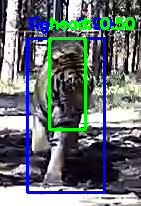

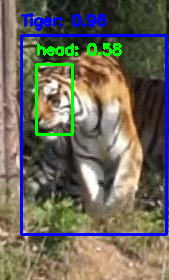

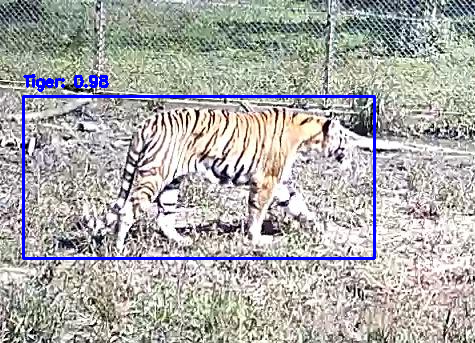

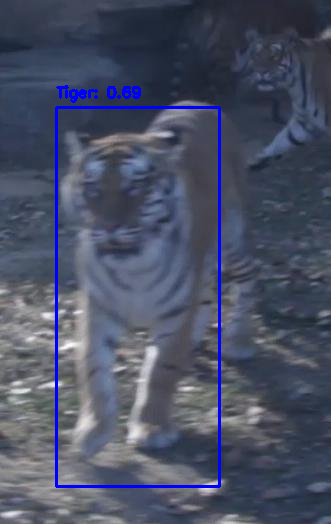

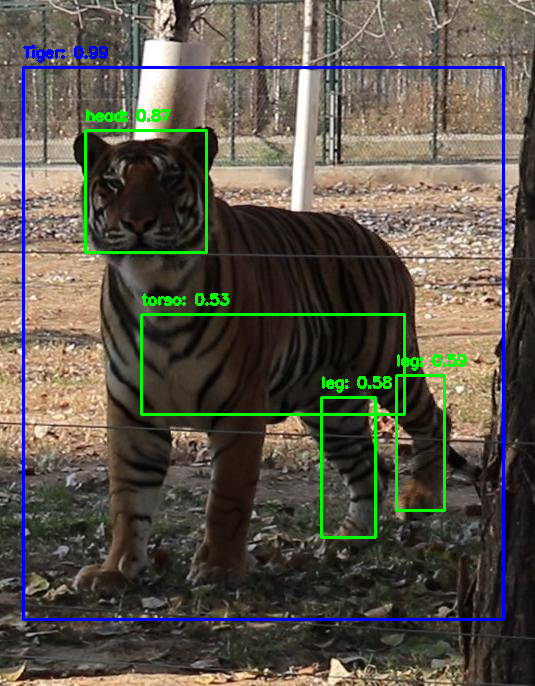

...

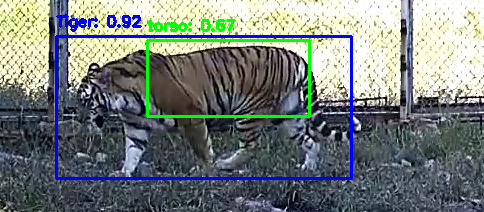

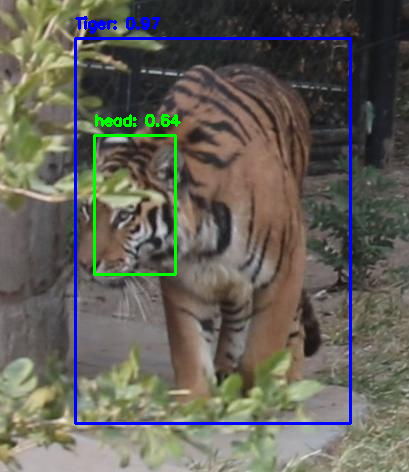

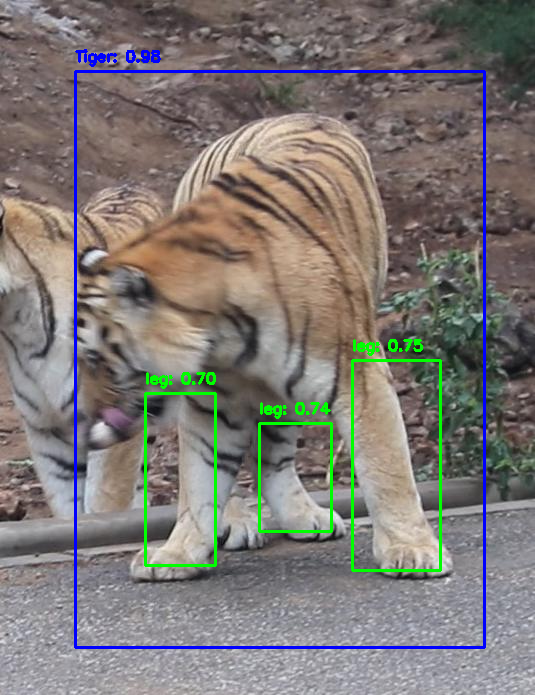

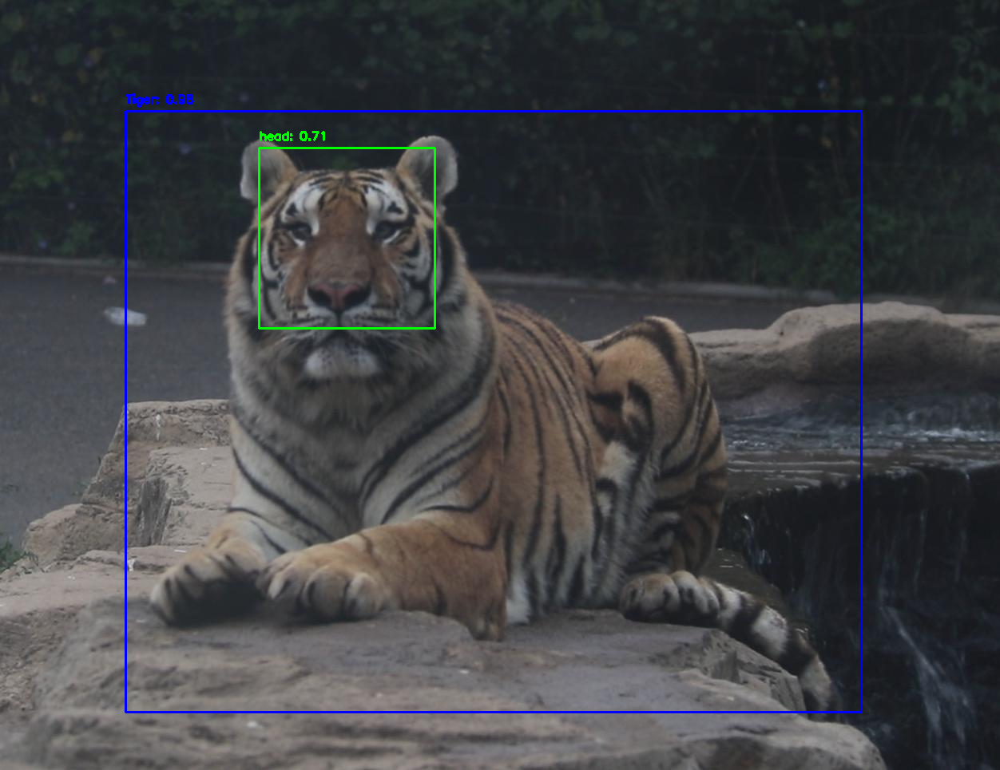

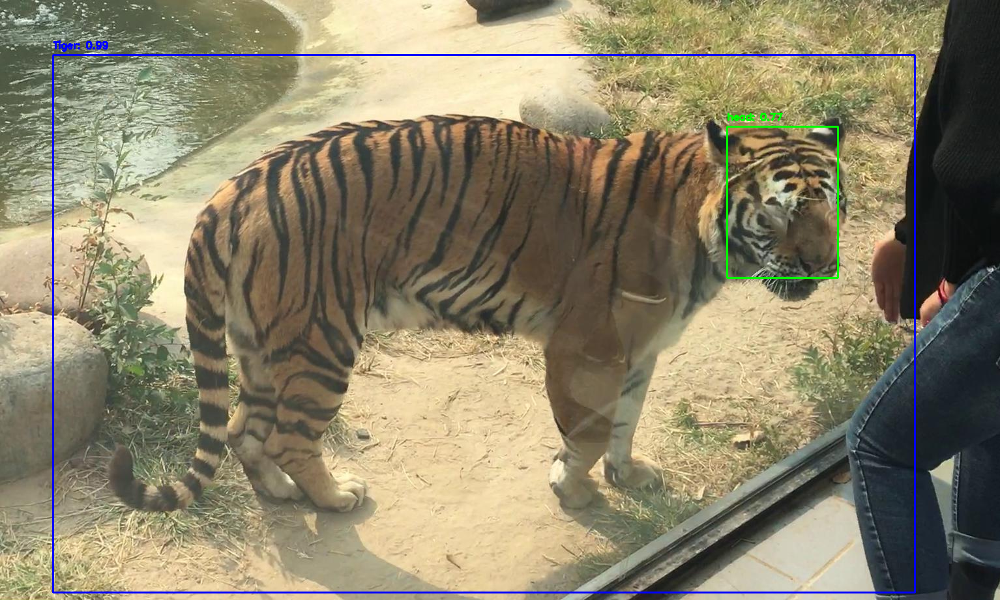

KeyboardInterrupt: 

In [ ]:
import numpy as np
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
import os
import cv2
from google.colab.patches import cv2_imshow

os.chdir('/content/drive/MyDrive/211_datasets')
# detector for part1: crop the whole tiger
base_options = python.BaseOptions(model_asset_path='exported_model/model.tflite')
options = vision.ObjectDetectorOptions(base_options=base_options,
                                       score_threshold=0.5)
detector = vision.ObjectDetector.create_from_options(options)

#detector for part2: draw the bbox of the body parts
base_options = python.BaseOptions(model_asset_path='exported_model2/model.tflite')
options = vision.ObjectDetectorOptions(base_options=base_options,
                                       score_threshold=0.5)
detector_2 = vision.ObjectDetector.create_from_options(options)

test_list = os.listdir('test/images')
os.chdir('test/images')

for img_name in test_list:
    mp_image = mp.Image.create_from_file(img_name)
    detection_result = detector.detect(mp_image) # the whole tigers
    img_copy = np.copy(mp_image.numpy_view())

    part2_drawing(detection_result, 0.5, 0.25, img_copy)



In [ ]:
import cv2
import numpy as np
import mediapipe as mp
import time


MODEL_PATH1 = 'model/model_1.tflite'
MODEL_PATH2 = 'model/model.tflite'

options_1 = mp.tasks.vision.ObjectDetectorOptions(
    base_options=mp.tasks.BaseOptions(model_asset_path=MODEL_PATH1),
    max_results=6,
    running_mode=mp.tasks.vision.RunningMode.VIDEO)

options_2 = mp.tasks.vision.ObjectDetectorOptions(
    base_options=mp.tasks.BaseOptions(model_asset_path=MODEL_PATH2),
    max_results=6,
    running_mode=mp.tasks.vision.RunningMode.IMAGE)

print(mp.__version__)

detector_1 = mp.tasks.vision.ObjectDetector.create_from_options(options_1)
detector_2 = mp.tasks.vision.ObjectDetector.create_from_options(options_2)

# Load video with OpenCV.
video = cv2.VideoCapture('tiger_walking.mp4')
video_fps = video.get(cv2.CAP_PROP_FPS)
frame_width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH)) * 2
frame_height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT)) * 2

fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec
out = cv2.VideoWriter('output_ultralytics.mp4', fourcc, 5.0, (frame_width, frame_height))

frame_index = 0
while video.isOpened():
    ret, frame = video.read()
    if not ret:
        break

    # Convert the BGR image to RGB and then to MediaPipe Image format.
    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    mp_frame = mp.Image(image_format=mp.ImageFormat.SRGB, data=rgb_frame)
    img_copy = np.copy(mp_frame.numpy_view())

    # Calculate the timestamp for the current frame in microseconds.
    frame_timestamp_us = int(1000000 * frame_index / video_fps)

    # Perform object detection using the timestamp in microseconds.
    detection_result = detector_1.detect_for_video(mp_frame, frame_timestamp_us)

    # Process detection results, draw bounding boxes and labels, etc.
    # Draw bounding boxes and labels on the frame.

    for detection in detection_result.detections:
        bbox = detection.bounding_box
        x, y, w, h = int(bbox.origin_x), int(bbox.origin_y), int(bbox.width), int(bbox.height)

        # Prepare label text.
        label = detection.categories[0].category_name if detection.categories else "Unknown"
        score = detection.categories[0].score if detection.categories else 0
        label_text = f"{label}: {score:.2f}"

        #timestamp_incre = 1
        if score > 0.5:
            # Draw bounding box on the frame.
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 0, 255), 2)
            # Put label text on the frame.
            cv2.putText(frame, label_text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
            cropped_frame = img_copy[y:y+h, x:x+w]
            cropped_frame = cropped_frame.astype(np.uint8)
            cropped_frame = mp.Image(image_format=mp.ImageFormat.SRGB, data=cropped_frame)
            body_result = detector_2.detect(cropped_frame)

            for body_part in body_result.detections:
                label = body_part.categories[0].category_name if body_part.categories else "Unknown"
                score_ = body_part.categories[0].score
                if label == 'leg':
                    label = 'torso'
                elif label == 'torso':
                    label == 'leg'
                label_text = f"{label}: {score_:.2f}"
                if score_ > 0.:
                    cropped_bbox = body_part.bounding_box
                    start_p = x + cropped_bbox.origin_x, y + cropped_bbox.origin_y
                    end_p = start_p[0] + cropped_bbox.width, start_p[1] + cropped_bbox.height
                    cv2.rectangle(frame, start_p, end_p, (0, 255, 0), 2)
                    cv2.putText(frame, label_text, (start_p[0], start_p[1] - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
            #timestamp_incre += 1


    out.write(frame)
    frame_index += 1

    # Display the frame with bounding boxes.
    cv2.imshow("Object Detection", frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

video.release()
out.release()
cv2.destroyAllWindows()


### Group Members
- Yi-Chun Lo
  - Email: yichunlo0919@g.ucla.edu
  - Github: https://github.com/yichunlo
- Gian:
  - Email: grz@cs.ucla.edu
  - Github: https://github.com/zignago
- Tai-Chang Zhou
  - Email: tzhouam@gmail.com
  - Github: https://github.com/tzhouam

### Contribution
- Yi-Chun Lo
  - Surveyed on the MobileNets paper and generate a [report](https://hackmd.io/@VQqE-CKVQUqUrHBxBk33bw/BkmEoZ1oT) to verify the network meet our goals.
  - Reconstructed ATRW dataset structures to fit the mediapipe coco dataloader.
  - Set up the pipeline of the task successfully.

- Gian Zignago
  - Surveyed papers on open source object detection metrics for use in evaluation of our model.
  - Wrote the final report documenting our project and the analysis of our results.